* extract candidates pair images based on acquisition properties (incidence angle)

In [114]:
from pystac_client import Client
from pystac import Catalog
import pandas as pd
import matplotlib.pyplot as plt
import leafmap.foliumap as leafmap
from shapely import Polygon
from shapely.geometry import box
import geopandas as gpd
import rasterio
from rasterio.plot import show
import numpy as np
from typing import Dict, List, Optional, Union, Any
import concurrent.futures
import re
from pydantic import ValidationError, BaseModel
import socket
from tqdm import tqdm
import pystac
from urllib.error import URLError
from urllib.request import urlopen
from datetime import datetime
import pickle
import requests
from requests import Session
from threading import local
import pprint as pp
import os
from pathlib import Path
import logging
import osmnx as ox
import itertools
import uuid
from skimage import io

logging.basicConfig()
logger = logging.getLogger(__name__)
logger.setLevel(logging.INFO)

pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', 100)

In [115]:
from src.config import *
from src.io.utils_io import load_maxar_items, load_rs_path_toy, load_roi_town,make_path, check_dir,save_pickle, load_pickle
from src.utils import create_bbox, get_maxar_items_on_roi

In [116]:
town_test = "Tafeghaghte"
date_event = '2023-09-09'
type_item="visual"
s_buffer=200

In [117]:
box_seism = [-8.753357,30.744196,-7.673950,31.360673]
box_seism = gpd.GeoDataFrame(geometry=[box(*box_seism)], crs=4326).to_crs(CRS)

In [118]:
gdf = load_maxar_items(type_item=type_item)

### Communes

* clip on box_seism

In [6]:
communes = gpd.read_file(make_path("communes_wgs84.shp", external_dir_path, "communes_wgs84")).to_crs(CRS)

In [7]:
communes.geometry.within(box_seism.geometry).sum()

0

In [8]:
communes.sjoin(box_seism, how="inner", predicate="within").explore()

In [9]:
print(communes.shape)
print(communes.Code_Commu.nunique())
print(communes.Nom_Commun.nunique())

(1534, 13)
1534
1525


In [10]:
inner_communes = gpd.sjoin(communes, box_seism, how="inner", predicate="within").drop("index_right", axis=1)

In [11]:
inner_communes.columns

Index(['OBJECTID', 'Code_Commu', 'Nom_Commun', 'Type_Commu', 'Pop2004',
       'Code_Provi', 'Nb_Menage', 'Dens2004', 'Surface', 'Code_Regio',
       'Shape_area', 'Shape_len', 'geometry'],
      dtype='object')

In [12]:
inner_communes.explore()

In [13]:
# join on intersects
items_communes = inner_communes.sjoin(gdf)

In [74]:
items_communes.after_event.value_counts()

after_event
0    1580
1     433
Name: count, dtype: int64

In [75]:
items_communes.platform.value_counts()

platform
WV03    1030
WV02     833
GE01     150
Name: count, dtype: int64

In [14]:
items_region_cnt = (
    items_communes
    .groupby('Code_Commu')
    ['after_event']
    .value_counts()
    .to_frame()
    .reset_index(level=1)
)

In [15]:
items_region_cnt = (
    pd.pivot(items_region_cnt, 
             columns=["after_event"], 
             values="count"
    ).rename({0:"cnt_before", 
              1:"cnt_after"}, 
         axis=1)
    .fillna(0)
)

In [16]:
items_region_cnt = items_region_cnt.join(communes.set_index("Code_Commu")[["geometry", "Nom_Commun"]])

In [17]:
items_region_cnt = gpd.GeoDataFrame(items_region_cnt, crs=CRS)

In [19]:
m=items_region_cnt.explore(
    column="cnt_before"
)
m

In [20]:
m=items_region_cnt.explore(
    column="cnt_after"
)
m

In [72]:
items_region_cnt.head(3)

,cnt_before,cnt_after,geometry,Nom_Commun
Code_Commu,,,,
041.05.01.,23.0,18.0,"POLYGON ((574739.832 3458110.021, 575559.462 3...",AMGHRAS
041.05.03.,25.0,12.0,"POLYGON ((567217.617 3457525.204, 567331.651 3...",AMIZMIZ
041.05.05.,64.0,27.0,"POLYGON ((569164.013 3452005.332, 569747.293 3...",ANOUGAL


In [ ]:
items_region_cnt

In [23]:
town_selection = [
    "TALAT_NYAAQOUB",
    "IGHIL",
    "AZGOUR", 
    "ANOUGAL", 
    "IMGDAL",
    "IJOUKAK"
]

select areas with enough after data => filter afterwards

In [21]:
#regions = items_communes_cnt[items_communes_cnt.Nom_Commun.isin(town_selection)]
items_region_cnt = items_region_cnt[(items_region_cnt.cnt_after > 0) & (items_region_cnt.cnt_before > 0)].copy()

In [22]:
area_final = gpd.GeoDataFrame(geometry=[items_region_cnt.unary_union], crs=CRS)

selects maxars items

In [23]:
items_selected = gdf.sjoin(area_final, predicate="within")

In [24]:
items_selected.href.nunique()

619

In [25]:
items_selected.shape

(619, 24)

#### extract town coordinates on area

In [26]:
#coop_path = os.path.join(building_root_path, "building_COOP", "MAR.parquet")
#coop = gpd.read_parquet(coop_path)

In [27]:
s_buffer = 300

In [28]:
def extract_places_osm(shape: Union[gpd.GeoDataFrame, Polygon], crs_out=CRS):

    if isinstance(shape, gpd.GeoDataFrame): 
        if not shape.crs == 4326:
            shape = shape.to_crs(4326)
        shape = shape.geometry.item()
        
    res = ox.features_from_polygon(shape, tags={"place":True})
    
    town_area = (
        res
        .loc["node", ["name:fr", "place", "geometry"]]
        .reset_index()
        .rename({"name:fr":"town_name"}, axis=1)
        .to_crs(CRS)
    )
    nb_nan = town_area.town_name.isna().sum()
    town_area.loc[town_area.town_name.isna(), "town_name"] = list(map(str, np.arange(nb_nan)))

    return town_area

In [29]:
shape_area = area_final.to_crs(4326).geometry.item()
town_area = extract_places_osm(shape_area)

In [30]:
town_area.shape

(763, 4)

In [31]:
m=area_final.explore()
town_area.explore(m=m)

In [32]:
s_buffer

300

In [33]:
town_area.geometry = town_area.buffer(s_buffer)

In [34]:
town_area = gpd.sjoin(town_area, area_final, how="inner", predicate="within").drop("index_right", axis=1)

In [35]:
items_roi = gpd.sjoin(town_area, gdf, how="inner", predicate="within").drop("index_right", axis=1)

In [36]:
items_roi.shape

(3050, 26)

In [37]:
items_roi.explore()

In [38]:
items_town_cnt = items_roi.groupby("town_name").after_event.value_counts().to_frame().reset_index() 

items_town_cnt = (
    pd.pivot(items_town_cnt, 
             index="town_name",
             columns=["after_event"], 
             values="count"
    ).rename({0:"cnt_before", 
              1:"cnt_after"}, 
         axis=1)
    .fillna(0)
)
items_town_cnt.head(3)

after_event,cnt_before,cnt_after
town_name,,
0,2.0,1.0
1,2.0,2.0
10,5.0,0.0


In [39]:
items_town_cnt.cnt_after.describe()

count    686.000000
mean       1.142857
std        0.736930
min        0.000000
25%        1.000000
50%        1.000000
75%        2.000000
max        3.000000
Name: cnt_after, dtype: float64

In [40]:
items_town_cnt.cnt_before.describe()

count    686.000000
mean       3.303207
std        1.225599
min        1.000000
25%        2.000000
50%        3.000000
75%        4.000000
max        8.000000
Name: cnt_before, dtype: float64

In [41]:
items_roi = pd.merge(items_roi, gdf[["href", "geometry"]].rename({"geometry":"geometry_tile"}, axis=1), how="inner", on="href")

In [42]:
items_roi.head(2)

,osmid,town_name,place,geometry,id,type,title,href,datetime,platform,gsd,catalog_id,utm_zone,quadkey,view_off_nadir,view_azimuth,view_incidence_angle,view_sun_azimuth,view_sun_elevation,proj_epsg,grid_code,data_area,clouds_area,clouds_percent,geometry_bbox,after_event,geometry_tile
0,653133192,Ait Zitoun,village,"POLYGON ((586953.601 3432135.881, 586952.156 3...",29/120202030003/103001008244DA00,image/tiff; application=geotiff; profile=cloud...,Visual Image,https://maxar-opendata.s3.amazonaws.com/events...,2018-08-09 11:28:16Z,WV02,0.47,103001008244DA00,29,120202030003,8.9,159.5,80.0,129.5,68.0,32629,MXRA-Z29-120202030003,28.203125,0.600098,2.0,"[584843.75, 3429843.75, 590156.25, 3435156.25]",0,"POLYGON ((584843.750 3435156.250, 590156.250 3..."
1,667305354,iguidi,village,"POLYGON ((585618.263 3432387.672, 585616.818 3...",29/120202030003/103001008244DA00,image/tiff; application=geotiff; profile=cloud...,Visual Image,https://maxar-opendata.s3.amazonaws.com/events...,2018-08-09 11:28:16Z,WV02,0.47,103001008244DA00,29,120202030003,8.9,159.5,80.0,129.5,68.0,32629,MXRA-Z29-120202030003,28.203125,0.600098,2.0,"[584843.75, 3429843.75, 590156.25, 3435156.25]",0,"POLYGON ((584843.750 3435156.250, 590156.250 3..."


In [48]:
m = items_roi.explore(style_kwds=dict(color="red",fillColor="red"), popup=True, zoom_start=10)
items_roi[["geometry_tile"]].drop_duplicates().set_geometry("geometry_tile").explore(m=m, style_kwds=dict(fillOpacity=0.1))

In [49]:
items_roi.columns

Index(['osmid', 'town_name', 'place', 'geometry', 'id', 'type', 'title',
       'href', 'datetime', 'platform', 'gsd', 'catalog_id', 'utm_zone',
       'quadkey', 'view_off_nadir', 'view_azimuth', 'view_incidence_angle',
       'view_sun_azimuth', 'view_sun_elevation', 'proj_epsg', 'grid_code',
       'data_area', 'clouds_area', 'clouds_percent', 'geometry_bbox',
       'after_event', 'geometry_tile'],
      dtype='object')

### Extract nearest items after / before based on acquisition meta

In [79]:
match_town = {}
s_bbox=None
for name in items_roi.town_name.unique(): 
    match_town[name] = {}
    for temp, v in zip(["after", "before"], [1, 0]):
        match_town[name][temp] = items_roi[(items_roi.town_name == name) & (items_roi.after_event == v)].reset_index(drop=True)

In [80]:
gdf.columns

Index(['id', 'type', 'title', 'href', 'datetime', 'platform', 'gsd',
       'catalog_id', 'utm_zone', 'quadkey', 'view_off_nadir', 'view_azimuth',
       'view_incidence_angle', 'view_sun_azimuth', 'view_sun_elevation',
       'proj_epsg', 'grid_code', 'data_area', 'clouds_area', 'clouds_percent',
       'geometry_bbox', 'geometry', 'after_event'],
      dtype='object')

In [81]:
col_global = [
           'town_name',
           'geometry',
            'quadkey'
]
col_modelisation = [
           'href',
           'view_off_nadir', 
           'view_azimuth',
           'view_incidence_angle', 
           'view_sun_azimuth', 
           'view_sun_elevation',
           'platform',
            'clouds_percent',
            ]
col_tot = col_global + col_modelisation

cross_items = []

for name, temp_df in match_town.items():
    b_values = temp_df["before"][col_tot].values
    a_values = temp_df["after"][col_modelisation].values
    prod =  [np.hstack(_) for _ in itertools.product(b_values, a_values)]

    cross_items.extend(prod)

columns_cross = col_global + [f"before_{_}" for _ in col_modelisation] +  [f"after_{_}" for _ in col_modelisation]
cross_items = pd.DataFrame(cross_items, columns=columns_cross)
cross_items["id_pair"] = np.arange(len(cross_items))

cross_items["diff_view_off_nadir"] = np.abs(cross_items[["before_view_off_nadir", "after_view_off_nadir"]].diff(axis=1)["after_view_off_nadir"])
cross_items["diff_view_incidence"] = np.abs(cross_items[["before_view_incidence_angle", "after_view_incidence_angle"]].diff(axis=1)["after_view_incidence_angle"])

cross_items["diff_view_sun_azimuth"] = np.abs(cross_items[["before_view_sun_azimuth", "after_view_sun_azimuth"]].diff(axis=1)["after_view_sun_azimuth"])

#"diff_view_sun_azimuth"
cross_items["diff_avg"] = cross_items[["diff_view_off_nadir", "diff_view_incidence"]].apply(np.mean, axis=1)

In [82]:
cross_items.shape

(2668, 24)

In [83]:
cross_items.diff_avg.describe()

count    2668.000000
mean       14.139655
std        10.350757
min         0.200000
25%         5.174999
50%        14.675001
75%        19.750000
max        40.799999
Name: diff_avg, dtype: float64

In [94]:
cross_items = cross_items.sort_values("diff_avg")

In [96]:
cross_items_unique = cross_items.groupby("town_name", as_index=False).first()

In [ ]:
cross_items_unique.dif

In [97]:
q_list = np.arange(0, 1.1, 0.1)

cnt_q = {}
for q in q_list:
    q_v = cross_items_unique.diff_avg.quantile(q)
    cnt_q[q_v] = cross_items_unique[cross_items_unique.diff_avg < q_v].shape[0]

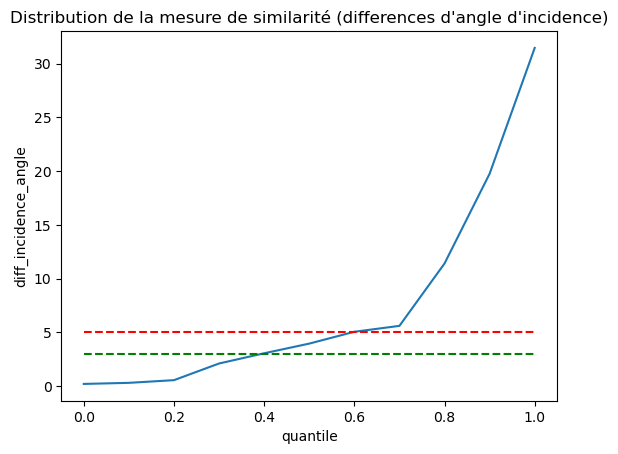

In [113]:
q_values = list(cnt_q)
cnt = list(cnt_q.values())
plt.plot(q_list, q_values)
plt.xlabel("quantile")
plt.ylabel("diff_incidence_angle")
plt.title("Distribution de la mesure de similarité (differences d'angle d'incidence)")
plt.hlines(y=5, xmin=0, xmax=1, color="red", linestyles="dashed")
plt.hlines(y=3, xmin=0, xmax=1, color="green", linestyles="dashed")

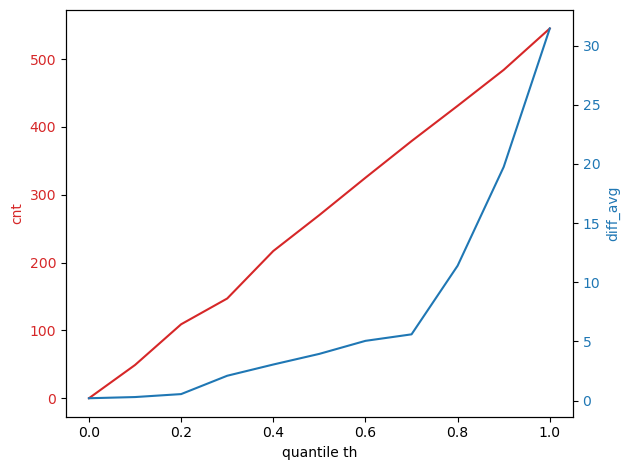

In [104]:
fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.set_xlabel('quantile th')
ax1.set_ylabel('cnt', color=color)
ax1.plot(q_list, cnt, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('diff_avg', color=color)  # we already handled the x-label with ax1
ax2.plot(q_list, q_values, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()

In [ ]:
cross_items

In [50]:
out_dir = Path(project_path, "data", "tmp", "min_diff_avg")
items = load_pickle(os.path.join(out_dir, f"items_min_diff_roi.pkl"))

In [76]:
gdf.columns

Index(['id', 'type', 'title', 'href', 'datetime', 'platform', 'gsd',
       'catalog_id', 'utm_zone', 'quadkey', 'view_off_nadir', 'view_azimuth',
       'view_incidence_angle', 'view_sun_azimuth', 'view_sun_elevation',
       'proj_epsg', 'grid_code', 'data_area', 'clouds_area', 'clouds_percent',
       'geometry_bbox', 'geometry', 'after_event'],
      dtype='object')

In [54]:
res = filter_items(cross_items, "diff_avg", 3)

In [55]:
res.shape

(269, 24)

In [56]:
res.town_name.nunique()

183

In [51]:
from src.rs_processing.processing import crop_rs_on_shape

def crop_pair_raster(row: gpd.GeoSeries, 
                     out_dir , 
                     s_buffer: int, 
                     b_name:str=None, 
                     a_name:str=None):
    
    if b_name is None and a_name is None:
        b_name = '_'.join([row.quadkey, Path(row.before_href).stem+".tif"])
        a_name = '_'.join([row.quadkey, Path(row.after_href).stem+".tif"])
    
    shape = box(*row.geometry.buffer(s_buffer).bounds)

    b_out_dir = check_dir(out_dir, "before")
    a_out_dir = check_dir(out_dir, "after")

    
    b_local_path = crop_rs_on_shape(row.before_href, 
                     shape,
                     out_path=os.path.join(b_out_dir, f"{b_name}")
    )

    a_local_path = crop_rs_on_shape(row.after_href, 
                     shape,
                     out_path=os.path.join(a_out_dir, f"{a_name}")
    )

    return b_local_path, a_local_path


def filter_items(cross_items, field:str, th_field:Union[float, int], th_cloud:float=2.):
    if field == "corr": 
        # just to remember to change operator <
        raise ValueError("please adapt operator th_field")
    cross_items = cross_items[
    (cross_items.before_clouds_percent < th_cloud) & 
    (cross_items.after_clouds_percent < th_cloud) &
    (cross_items[field] < th_field)
    ]
    return cross_items
    
    
def extract_dataset_on_meta(cross_items,
                            s_buffer:int, 
                            th_field,
                            out_dir_rs: str=None,
                            resume_out_path: str=None,
                            field: str="diff_avg", 
                            ascending:bool=True):

    town_track = []
    df_save = []
    cnt=0
    
    cross_items = filter_items(cross_items, field,  th_field=th_field)
    cross_items = (
        cross_items
        .sort_values(field, ascending=ascending)
        .reset_index(drop=True)
    )
    cross_items.geometry = cross_items.geometry.centroid

    for i, row in tqdm(cross_items.iterrows()):
        
        #if cnt == 3: break
        if row.town_name in town_track: continue

        id_pair = str(uuid.uuid4())

        #b_name = '_'.join([row.quadkey, Path(row.before_href).stem+".tif"])
        #a_name = '_'.join([row.quadkey, Path(row.after_href).stem+".tif"])

        b_name = f"{id_pair}.tif"
        a_name = f"{id_pair}.tif"
        
        b_local_path, a_local_path = None, None
    
        if out_dir_rs:
            b_local_path, a_local_path = crop_pair_raster(row, 
                                                          out_dir_rs,
                                                          s_buffer,
                                                          b_name, 
                                                          a_name)
        
        df_save.append(
            [
                b_local_path, 
                a_local_path, 
            ] +  list(row)
        )

    
        town_track.append(row.town_name)
    
        cnt +=1
        
    df_save = pd.DataFrame(df_save, columns = ["before_path", "after_path"] + list(row.index))
    df_save = gpd.GeoDataFrame(df_save, geometry="geometry", crs=CRS)
    if resume_out_path:
        save_pickle(df_save, resume_out_path)
    return df_save

In [58]:
cross_items = gpd.GeoDataFrame(cross_items, geometry="geometry", crs=CRS)

check illumintaion before / after : `90731b82-2445-46cf-9ee4-6fbccf6b4d4a`

In [52]:
out_dir_rs = check_dir(interim_dir_path, "dataset", "tif")
resume_out_path = check_dir(interim_dir_path, "dataset")

In [299]:


s_buffer=157
type_item = "visual"
res = extract_dataset_on_meta(cross_items, 
                              th_field=3, 
                              s_buffer=s_buffer, 
                              out_dir_rs = out_dir_rs,
                              resume_out_path=os.path.join(resume_out_path, f"dataset_{type_item}_{s_buffer}.pkl"))

269it [21:02,  4.70s/it]


In [55]:
s_buffer=157
resume = load_pickle(os.path.join(resume_out_path, f"dataset_{type_item}_{s_buffer}.pkl"))

In [56]:
#resume = load_pickle(make_path("dataset_visual_157.pkl", processed_dir_path, "dataset", "png"))

In [58]:
resume.groupby([_ for _ in resume.columns if "platform" in _]).size()

before_platform  after_platform
WV03             WV02              124
                 WV03               59
dtype: int64

In [59]:
resume.town_name.nunique()

183

In [61]:
len(resume)

183

In [60]:
resume.columns

Index(['before_path', 'after_path', 'town_name', 'geometry', 'quadkey',
       'before_href', 'before_view_off_nadir', 'before_view_azimuth',
       'before_view_incidence_angle', 'before_view_sun_azimuth',
       'before_view_sun_elevation', 'before_platform', 'before_clouds_percent',
       'after_href', 'after_view_off_nadir', 'after_view_azimuth',
       'after_view_incidence_angle', 'after_view_sun_azimuth',
       'after_view_sun_elevation', 'after_platform', 'after_clouds_percent',
       'id_pair', 'diff_view_off_nadir', 'diff_view_incidence',
       'diff_view_sun_azimuth', 'diff_avg', 'before_path_png',
       'after_path_png', 'img_id', 'urban_area_path'],
      dtype='object')

In [ ]:
m = items_roi.explore(style_kwds=dict(color="red",fillColor="red"), popup=True, zoom_start=10)
items_roi[["geometry_tile"]].drop_duplicates().set_geometry("geometry_tile").explore(m=m, style_kwds=dict(fillOpacity=0.1))

In [78]:
resume.sort_values("diff_avg")

,before_path,after_path,town_name,geometry,quadkey,before_href,before_view_off_nadir,before_view_azimuth,before_view_incidence_angle,before_view_sun_azimuth,before_view_sun_elevation,before_platform,before_clouds_percent,after_href,after_view_off_nadir,after_view_azimuth,after_view_incidence_angle,after_view_sun_azimuth,after_view_sun_elevation,after_platform,after_clouds_percent,id_pair,diff_view_off_nadir,diff_view_incidence,diff_view_sun_azimuth,diff_avg,before_path_png,after_path_png,img_id,urban_area_path
0,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,480,POINT (545667.370 3454611.446),120202003203,https://maxar-opendata.s3.amazonaws.com/events...,28.000000,283.899994,59.0,130.1,75.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,28.200001,215.600006,58.8,146.6,59.7,WV03,0.0,2101,0.200001,0.2,16.5,0.200000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e,/home/rustt/Documents/Projects/building_damage...
1,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,91,POINT (580580.448 3431358.493),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,28,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,7c6e421b-866a-4ef4-b8b4-0cbbedacd46d,/home/rustt/Documents/Projects/building_damage...
2,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,114,POINT (580620.830 3431335.823),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,36,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,8510a085-9449-4c68-8506-99178fcf2d01,/home/rustt/Documents/Projects/building_damage...
3,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,118,POINT (580579.080 3431304.804),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,46,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,46069c75-000e-4b59-8892-25198ee96e0a,/home/rustt/Documents/Projects/building_damage...
4,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,604,POINT (540407.818 3452948.688),120202003202,https://maxar-opendata.s3.amazonaws.com/events...,27.799999,284.000000,59.3,130.1,75.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,28.000000,214.899994,59.0,146.6,59.7,WV03,0.0,2133,0.200001,0.3,16.5,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,51186d96-6b79-407a-be01-d5d2e2d147af,/home/rustt/Documents/Projects/building_damage...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,433,POINT (570172.821 3441174.049),120202003332,https://maxar-opendata.s3.amazonaws.com/events...,27.799999,74.599998,59.2,163.1,33.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.700001,114.599998,62.1,140.2,57.5,WV02,0.0,865,3.099998,2.9,22.9,2.999999,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,071fc49d-bea3-473c-8ebc-4a6c011dfff2,/home/rustt/Documents/Projects/building_damage...
1

In [63]:
viz = resume.copy()

In [67]:
viz["platform"] = viz.apply(lambda x: "WV03-WV02" if x["after_platform"] != x["before_platform"] else "WV03-WV03", axis=1)

In [71]:
viz_b = viz[viz["platform"] == "WV03-WV02"]
viz_a = viz[viz["platform"] == "WV03-WV03"]

m =viz_b.explore(column="platform", style_kwds={"color":"blue"})
viz_a.explore(column="platform", style_kwds={"color":"red"}, m=m)

### Convert to PNG

* resize to 1024
* histogram matching

In [62]:
from src.rs_processing.processing import histogram_alignment
import rioxarray as rioxr
import cv2

In [63]:
root_in_path = check_dir(interim_dir_path, "dataset")

tif_dir = make_path("tif", root_in_path)

In [64]:
before_files = os.listdir(check_dir(tif_dir, "before"))
after_files = os.listdir(check_dir(tif_dir, "after"))

print(before_files[:5])
print('===')
print(after_files[:5])

['c3f09d41-ae29-42d7-9c8b-74ffbae2684d.tif', '2cda025e-0b14-48cf-b304-31dff16989ac.tif', '25316528-23a3-403c-a204-5bf369e16bb3.tif', '06c5f930-99be-4350-92ac-83ec3f5fc66d.tif', 'a6d4b830-1a0f-4413-a890-a01b51d3c734.tif']
===
['c3f09d41-ae29-42d7-9c8b-74ffbae2684d.tif', '2cda025e-0b14-48cf-b304-31dff16989ac.tif', '25316528-23a3-403c-a204-5bf369e16bb3.tif', '06c5f930-99be-4350-92ac-83ec3f5fc66d.tif', 'a6d4b830-1a0f-4413-a890-a01b51d3c734.tif']


In [68]:
IM_SIZE =(1024, 1024)
preprocess = True
s_buffer=157

root_in_path = check_dir(interim_dir_path, "dataset")

tif_dir = make_path("tif", root_in_path)
png_dir = check_dir(processed_dir_path, "dataset", "png")

path_png = []

for b_name, a_name in zip(os.listdir(check_dir(tif_dir, "before")), os.listdir(check_dir(tif_dir, "after"))):

    b_path = make_path(b_name, tif_dir, "before")
    a_path = make_path(a_name, tif_dir, "after")

    rs_b = rioxr.open_rasterio(b_path).data.transpose(1, 2, 0)
    rs_a = rioxr.open_rasterio(a_path).data.transpose(1, 2, 0)

    rs_b = cv2.cvtColor(rs_b, cv2.COLOR_BGR2RGB)
    rs_a = cv2.cvtColor(rs_a, cv2.COLOR_BGR2RGB)

    if preprocess: 
        rs_b = cv2.resize(rs_b, (IM_SIZE))
        rs_a = cv2.resize(rs_a, (IM_SIZE))
        rs_a = histogram_alignment(rs_a, rs_b)

    dir_out_b, dir_out_a = check_dir(png_dir, "before"), check_dir(png_dir, "after")
        
    out_path_b = make_path(Path(b_name).stem+".png", dir_out_b)
    out_path_a = make_path(Path(a_name).stem+".png", dir_out_a)

    #cv2.imwrite(out_path_b, rs_b)
    #cv2.imwrite(out_path_a, rs_a)

    path_png.append((b_path, a_path, out_path_b, out_path_a,))

path_png = pd.DataFrame(path_png, columns=["before_path", "after_path", "before_path_png", "after_path_png"])

#resume = load_pickle(os.path.join(root_in_path, f"dataset_{type_item}_{s_buffer}.pkl"))
if "before_path_png" in resume.columns:
    resume = resume.drop(["before_path_png", "after_path_png"], axis=1)

resume = resume.merge(path_png, on=["before_path", "after_path"])
# resume = resume.assign(
#     before_path_png=[_[0] for _ in path_png], 
#     after_path_png=[_[1] for _ in path_png]    
# )
save_pickle(resume, make_path(f"dataset_{type_item}_{s_buffer}.pkl", png_dir))

In [69]:
resume.shape

(183, 28)

In [70]:
resume[["before_path", "before_path_png"]].values[:5]

array([['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e.png'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/7c6e421b-866a-4ef4-b8b4-0cbbedacd46d.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/7c6e421b-866a-4ef4-b8b4-0cbbedacd46d.png'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/8510a085-9449-4c68-8506-99178fcf2d01.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/8510a085-9449-4c68-8506-99178fcf2d01.png'],
       ['/home/rustt/Documents/Projects/building_damage/moroc

In [119]:
type_item, s_buffer = "visual", 157
png_dir = check_dir(processed_dir_path, "dataset", "png")
resume = load_pickle(make_path(f"dataset_{type_item}_{s_buffer}.pkl", png_dir))

In [120]:
resume

,before_path,after_path,town_name,geometry,quadkey,before_href,before_view_off_nadir,before_view_azimuth,before_view_incidence_angle,before_view_sun_azimuth,before_view_sun_elevation,before_platform,before_clouds_percent,after_href,after_view_off_nadir,after_view_azimuth,after_view_incidence_angle,after_view_sun_azimuth,after_view_sun_elevation,after_platform,after_clouds_percent,id_pair,diff_view_off_nadir,diff_view_incidence,diff_view_sun_azimuth,diff_avg,before_path_png,after_path_png,img_id,urban_area_path
0,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,480,POINT (545667.370 3454611.446),120202003203,https://maxar-opendata.s3.amazonaws.com/events...,28.000000,283.899994,59.0,130.1,75.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,28.200001,215.600006,58.8,146.6,59.7,WV03,0.0,2101,0.200001,0.2,16.5,0.200000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e,/home/rustt/Documents/Projects/building_damage...
1,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,91,POINT (580580.448 3431358.493),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,28,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,7c6e421b-866a-4ef4-b8b4-0cbbedacd46d,/home/rustt/Documents/Projects/building_damage...
2,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,114,POINT (580620.830 3431335.823),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,36,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,8510a085-9449-4c68-8506-99178fcf2d01,/home/rustt/Documents/Projects/building_damage...
3,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,118,POINT (580579.080 3431304.804),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,46,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,46069c75-000e-4b59-8892-25198ee96e0a,/home/rustt/Documents/Projects/building_damage...
4,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,604,POINT (540407.818 3452948.688),120202003202,https://maxar-opendata.s3.amazonaws.com/events...,27.799999,284.000000,59.3,130.1,75.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,28.000000,214.899994,59.0,146.6,59.7,WV03,0.0,2133,0.200001,0.3,16.5,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,51186d96-6b79-407a-be01-d5d2e2d147af,/home/rustt/Documents/Projects/building_damage...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,432,POINT (570145.324 3440344.381),120202003332,https://maxar-opendata.s3.amazonaws.com/events...,27.799999,74.599998,59.2,163.1,33.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.700001,114.599998,62.1,140.2,57.5,WV02,0.0,857,3.099998,2.9,22.9,2.999999,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,9bbce698-6baa-45c0-98ea-c694f489c0e5,/home/rustt/Documents/Projects/building_damage...
1

### Select dataset to label

In [316]:
resume.explore()

In [123]:
resume[["before_platform", "after_platform"]].value_counts()

before_platform  after_platform
WV03             WV02              124
                 WV03               59
Name: count, dtype: int64

In [122]:
resume.columns

Index(['before_path', 'after_path', 'town_name', 'geometry', 'quadkey',
       'before_href', 'before_view_off_nadir', 'before_view_azimuth',
       'before_view_incidence_angle', 'before_view_sun_azimuth',
       'before_view_sun_elevation', 'before_platform', 'before_clouds_percent',
       'after_href', 'after_view_off_nadir', 'after_view_azimuth',
       'after_view_incidence_angle', 'after_view_sun_azimuth',
       'after_view_sun_elevation', 'after_platform', 'after_clouds_percent',
       'id_pair', 'diff_view_off_nadir', 'diff_view_incidence',
       'diff_view_sun_azimuth', 'diff_avg', 'before_path_png',
       'after_path_png', 'img_id', 'urban_area_path'],
      dtype='object')

In [140]:
import shutil
n_sample_label = 20
np.random.seed(12)
dataset_labelled = load_pickle(make_path("dataset_labelled.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

exist_img_id = list(dataset_labelled.img_id)

candidates = resume[(resume["before_platform"] == "WV03") & (resume["after_platform"] == "WV02")]
selected_idx = []

for s in range(n_sample_label): 
    idx_sample = np.random.randint(0, len(candidates), size=1)[0]
    
    if candidates.iloc[idx_sample]["img_id"] not in exist_img_id: 
        selected_idx.append(idx_sample)
        
    if len(selected_idx) == 20: 
        break

In [141]:
selected_idx

[75, 27, 6, 113, 2, 67, 48, 22, 49, 52, 5, 89, 34, 75, 118, 74, 0]

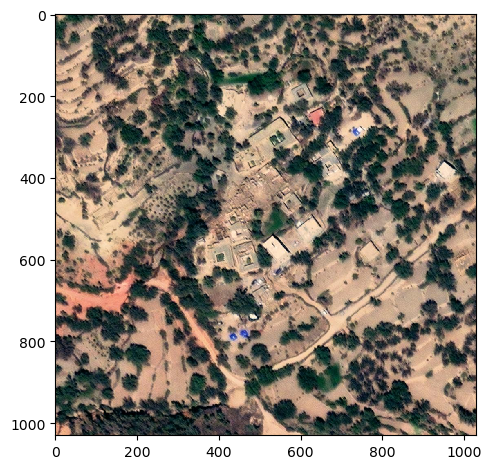

In [142]:
io.imshow(candidates.iloc[selected_idx[0]]["after_path"])

In [144]:
#idx_sample = np.random.randint(0, len(resume), size=n_sample_label)
#b_hrefs = list(resume.iloc[idx_sample].before_path_png)
#a_hrefs = list(resume.iloc[idx_sample].after_path_png)

b_hrefs = list(candidates.iloc[selected_idx].before_path_png)
a_hrefs = list(candidates.iloc[selected_idx].after_path_png)

out_dir = check_dir(processed_dir_path, "dataset", "png", "data_labelled", "extra")
out_dir_b = check_dir(processed_dir_path, "dataset", "png", "data_labelled","extra", "before")
out_dir_a = check_dir(processed_dir_path, "dataset", "png", "data_labelled", "extra", "after")

make_fname = lambda x: Path(x).stem+".png"

for file_b, file_a in zip(b_hrefs, a_hrefs):
    b_name = make_fname(file_b)
    a_name = make_fname(file_a)
    shutil.copy(file_b, make_path(b_name, out_dir_b))
    shutil.copy(file_a, make_path(a_name, out_dir_a))

In [328]:
resume.columns

Index(['before_path', 'after_path', 'town_name', 'geometry', 'quadkey',
       'before_href', 'before_view_off_nadir', 'before_view_azimuth',
       'before_view_incidence_angle', 'before_view_sun_azimuth',
       'before_view_sun_elevation', 'before_platform', 'before_clouds_percent',
       'after_href', 'after_view_off_nadir', 'after_view_azimuth',
       'after_view_incidence_angle', 'after_view_sun_azimuth',
       'after_view_sun_elevation', 'after_platform', 'after_clouds_percent',
       'id_pair', 'diff_view_off_nadir', 'diff_view_incidence',
       'diff_view_sun_azimuth', 'diff_avg', 'before_path_png',
       'after_path_png'],
      dtype='object')

#### Extract imgs with annotation - new imgs

In [146]:
out_dir = check_dir(processed_dir_path, "dataset", "png", "data_labelled", "extra")
meta_png = pd.read_csv(make_path("dataset_labelled.csv", out_dir))

In [151]:
def extract_fpath(row):
    name = '-'.join(row.split("/")[-1].split('-')[1:])
    return make_path(name, processed_dir_path, "dataset", "png", "data_labelled", "extra", "after")

In [152]:
# filter on extra imgs 
meta_png = meta_png[meta_png.id >= 20]
meta_png["after_path"] = meta_png.image.apply(extract_fpath)
meta_png["img_id"] = meta_png.after_path.apply(lambda x: Path(x).stem)
meta_png = meta_png[['img_id','annotation_id']]

/tmp/ipykernel_120985/716982156.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  meta_png["after_path"] = meta_png.image.apply(extract_fpath)
/tmp/ipykernel_120985/716982156.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  meta_png["img_id"] = meta_png.after_path.apply(lambda x: Path(x).stem)


In [153]:
meta_png

,img_id,annotation_id
19,d31052d1-ca71-48e0-9eb5-1212c3ab4684,20
20,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,21
21,2db3a8c0-d73c-4882-bee4-6feebf069345,22
22,2f661e17-7e85-409c-a4c4-a22ee62cf250,23
23,7c6e421b-866a-4ef4-b8b4-0cbbedacd46d,24
24,6871c09a-b170-43af-bfed-d51d7d158f90,26
25,acd6b1ca-6b84-4694-8ed3-8df918d7f843,27
26,ae30f79d-95be-4894-8e51-afd02e4b96c6,28
27,bc3a9c2a-f14e-4516-8703-2cec72063f60,29
28,c30fa89b-649a-4629-83e8-72909ef45102,30


#### Extract imgs with annotation

In [30]:
out_dir = check_dir(processed_dir_path, "dataset", "png", "data_labelled")
meta_png = pd.read_csv(make_path("dataset_labelled.csv", out_dir))

In [31]:
def extract_fpath(row):
    name = '-'.join(row.split("/")[-1].split('-')[1:])
    return make_path(name, processed_dir_path, "dataset", "png", "data_labelled", "after")

In [32]:
meta_png["after_path"] = meta_png.image.apply(extract_fpath)
meta_png["img_id"] = meta_png.after_path.apply(lambda x: Path(x).stem)
meta_png = meta_png[['img_id','annotation_id']]

In [154]:
labels_dir = make_path("labels", processed_dir_path, "dataset", "png", "data_labelled", "extra")
labels_id = [int(re.findall("[0-9]+", _)[1]) for _ in os.listdir(labels_dir)]
labels = pd.DataFrame(
    {
        "annotation_id":labels_id, 
        "labels_path":[
            make_path(_, labels_dir) for _ in os.listdir(labels_dir)
        ]
    }
)

In [157]:
labels.iloc[0].values

array([24,
       '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/extra/labels/task-24-annotation-24-by-1-tag-damage_building-0.png'],
      dtype=object)

In [158]:
meta_png

,img_id,annotation_id
19,d31052d1-ca71-48e0-9eb5-1212c3ab4684,20
20,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,21
21,2db3a8c0-d73c-4882-bee4-6feebf069345,22
22,2f661e17-7e85-409c-a4c4-a22ee62cf250,23
23,7c6e421b-866a-4ef4-b8b4-0cbbedacd46d,24
24,6871c09a-b170-43af-bfed-d51d7d158f90,26
25,acd6b1ca-6b84-4694-8ed3-8df918d7f843,27
26,ae30f79d-95be-4894-8e51-afd02e4b96c6,28
27,bc3a9c2a-f14e-4516-8703-2cec72063f60,29
28,c30fa89b-649a-4629-83e8-72909ef45102,30


In [35]:
labels

,annotation_id,labels_path
0,15,/home/rustt/Documents/Projects/building_damage...
1,6,/home/rustt/Documents/Projects/building_damage...
2,9,/home/rustt/Documents/Projects/building_damage...
3,2,/home/rustt/Documents/Projects/building_damage...
4,7,/home/rustt/Documents/Projects/building_damage...
5,1,/home/rustt/Documents/Projects/building_damage...
6,20,/home/rustt/Documents/Projects/building_damage...
7,16,/home/rustt/Documents/Projects/building_damage...
8,19,/home/rustt/Documents/Projects/building_damage...
9,5,/home/rustt/Documents/Projects/building_damage...


#### Extract full imgs meta

In [159]:
#meta_labels["before_path"] = meta_labels.after_path.apply(lambda x: "before".join(x.split("after")))
img_dir = make_path("before", processed_dir_path, "dataset", "png", "data_labelled", "extra")
before_meta = pd.DataFrame(
    {
        "img_id":[Path(_).stem for _ in os.listdir(img_dir)], 
        "before_path":[
            make_path(_, img_dir) for _ in os.listdir(img_dir)
        ]
    }
)

In [160]:
#meta_labels["before_path"] = meta_labels.after_path.apply(lambda x: "before".join(x.split("after")))
img_dir = make_path("after", processed_dir_path, "dataset", "png", "data_labelled", "extra")
after_meta = pd.DataFrame(
    {
        "img_id":[Path(_).stem for _ in os.listdir(img_dir)], 
        "after_path":[
            make_path(_, img_dir) for _ in os.listdir(img_dir)
        ]
    }
)

#### Merge meta

In [161]:
meta_labels = pd.merge(labels, meta_png, on="annotation_id", how="right")
meta_labels = pd.merge(meta_labels, after_meta, on="img_id", how="inner")
meta_labels = pd.merge(meta_labels, before_meta, on="img_id", how="inner")

In [162]:
meta_labels[["labels_path", "img_id", "after_path", "before_path"]].values[:3]

array([['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/extra/labels/task-21-annotation-21-by-1-tag-damage_building-0.png',
        '2c9db706-33a8-410a-9ea0-cc31bc7a1d52',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/extra/after/2c9db706-33a8-410a-9ea0-cc31bc7a1d52.png',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/extra/before/2c9db706-33a8-410a-9ea0-cc31bc7a1d52.png'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/extra/labels/task-22-annotation-22-by-1-tag-damage_building-0.png',
        '2db3a8c0-d73c-4882-bee4-6feebf069345',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/extra/after/2db3a8c0-d73c-4882-bee4-6feebf069345.pn

In [168]:
meta_labels.head(2)

,annotation_id,labels_path,img_id,after_path,before_path
0,21,/home/rustt/Documents/Projects/building_damage...,2c9db706-33a8-410a-9ea0-cc31bc7a1d52,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...
1,22,/home/rustt/Documents/Projects/building_damage...,2db3a8c0-d73c-4882-bee4-6feebf069345,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...


### Add to dataset_labelled

In [177]:
dataset_labelled = load_pickle(make_path("dataset_labelled.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

In [178]:
# not use anymore - compute on the fly
dataset_labelled = dataset_labelled.drop("urban_area_path", axis=1)

In [180]:
dataset_labelled = pd.concat([dataset_labelled, meta_labels], axis=0,  ignore_index=True)

In [184]:
len(dataset_labelled)

29

In [183]:
save_pickle(dataset_labelled, make_path("dataset_labelled.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

In [163]:
label_path, _, after_path, before_path = meta_labels[["labels_path", "img_id", "after_path", "before_path"]].dropna().sample().values.squeeze()

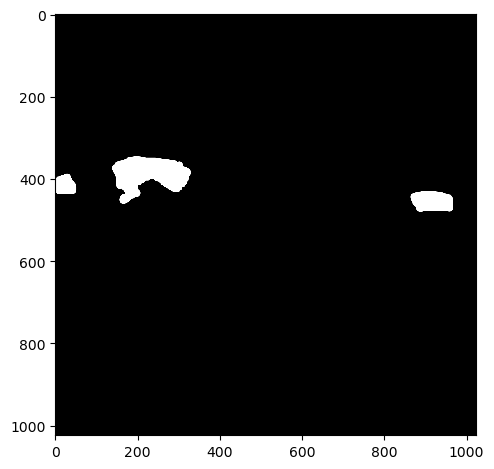

In [164]:
io.imshow(io.imread(label_path))

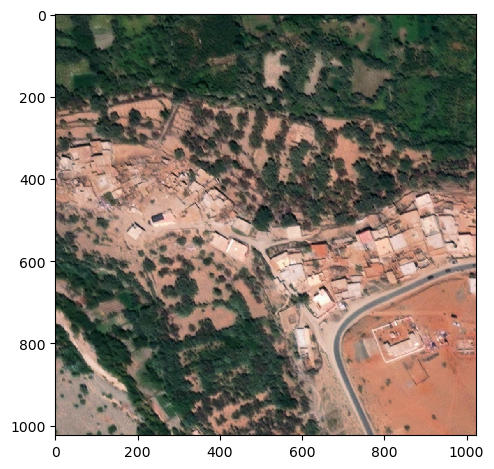

In [165]:
io.imshow(io.imread(after_path))

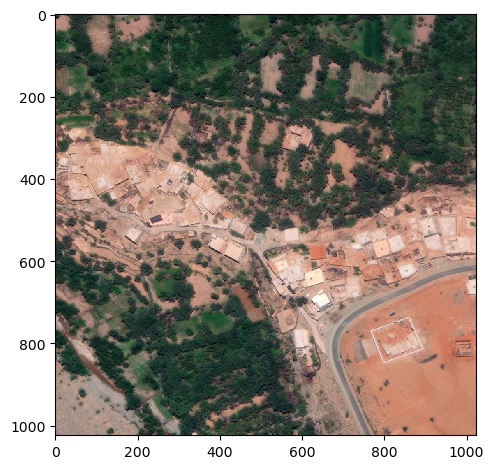

In [166]:
io.imshow(io.imread(before_path))